In [1]:
import pandas as pd
import numpy as np

from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

from random import randint as rand
from math import log,pi as PI

In [2]:
# Leo el archivo de las estaciones
stations = pd.read_csv('data/station.csv')

# Cambio el formato de las fechas
stations['installation_date'] = pd.to_datetime(stations['installation_date'])
stations.rename(columns={'installation_date':'date'}, inplace=True)

In [3]:
# Leo el archivo de los viajes
trips = pd.read_csv('data/trip.csv')

# Elimino este dato ya que no creo que sea relevante
del(trips['zip_code'])

# Cambio el formato de las fechas y tiempos de incio y fin de cada viaje
trips['start_date'] = pd.to_datetime(trips['start_date'], format='%m/%d/%Y %H:%M')
trips['end_date'] = pd.to_datetime(trips['end_date'], format='%m/%d/%Y %H:%M')

trips.rename(columns={'start_date': 's_date',
                      'end_date': 'e_date',
                      'start_station_name': 'ss_name',
                      'start_station_id': 'ss_id',
                      'end_station_name': 'es_name',
                      'end_station_id': 'es_id',
                      'subscription_type': 'subs'
                     }, inplace=True)

### Suscriptores vs Clientes

Quienes utilizan mas el servicio? Suscriptores o clientes comunes?

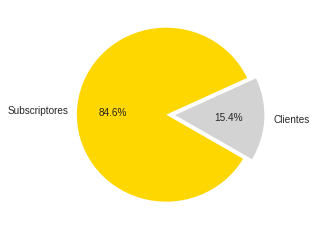

In [4]:
subs = trips.groupby('subs', as_index=False).count()[['subs', 'id']]

#Obtengo la cantidad de viajes realizados por cada tipo de suscripcion
cant_cust = subs[subs.subs == 'Customer']['id'].values
cant_subs = subs[subs.subs == 'Subscriber']['id'].values

plt.figure(figsize=(4, 4))
plt.pie([cant_subs, cant_cust],
        explode=(0.1, 0),
        labels=['Subscriptores', 'Clientes'],
        startangle=25,
        colors=['gold', 'lightgrey'],
        autopct='%1.1f%%'
       )
plt.show()

### Visualizacion de la cantidad de bicicletas de todas las estaciones

Lo que se quiere lograr es ver la proporcion de uso de bicicletas entre estaciones

In [5]:
#Obtengo la cantidad total de viajes iniciados de todas las estaciones
estaciones_uso = trips.groupby('ss_name')['id'].count().sort_values(ascending=False)

#Por motivos de visualizacion, escalo la cantidad de viajes iniciados de cada estacion
pop_estacion = estaciones_uso.map(lambda x:float(x)/10).values

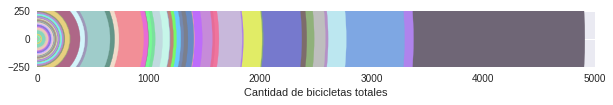

In [6]:
fig, ax = plt.subplots()
ax.set_aspect(1)
ax.set_xlim((0,5000))
ax.set_ylim((-250,250))
fig.set_size_inches(10,20)

for cant in pop_estacion:
    ax.add_artist(plt.Circle((0, 0), cant, color='#%02X%02X%02X' % (rand(100,255), rand(100,255), rand(100,255))))

plt.xlabel('Cantidad de bicicletas totales');
plt.show();

### Uso de Estaciones por candtidad de bicicletas totales

In [7]:
# Ordeno los viajes por id
trips = trips.sort_values(by='id')

#### Uso de estaciones incluyendo todos los años

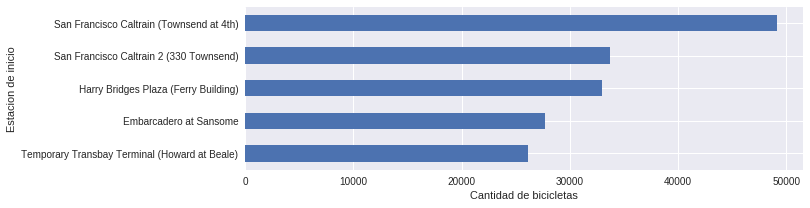

In [8]:
trips_13_15 = trips.groupby('ss_name')[['id']].count().sort_values(by='id', ascending=True)
trips_13_15.id[-5:].plot.barh(stacked=True, figsize=(10, 3));

plt.ylabel('Estacion de inicio');
plt.xlabel('Cantidad de bicicletas');

#### Estaciones iniciales mas utilizadas clasificadas por año

Se quiere ver cuantas bicicletas, en determinado año, se utilizaron en cada estacion.

Para ello separamos los dataframes por año.

In [9]:
#Se filtra por año
trips_2013 = trips[(trips['s_date'] < '2014')].reset_index()
trips_2014 = trips[('2014' < trips['s_date']) & (trips['s_date'] < '2015')].reset_index()
trips_2015 = trips['2015' < trips['s_date']].reset_index()

#Luego se hace el cuento de bicicleta que partieron de las estaciones usadas en cada año
trips_2013 = trips_2013.groupby('ss_name')['id'].count().sort_values(ascending=True)
trips_2014 = trips_2014.groupby('ss_name')['id'].count().sort_values(ascending=True)
trips_2015 = trips_2015.groupby('ss_name')['id'].count().sort_values(ascending=True)

#### 2013

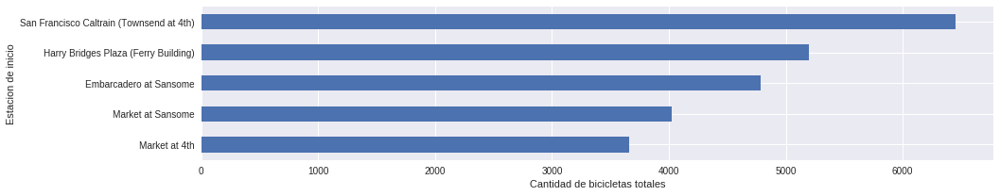

In [10]:
trips_2013[-5:].plot.barh(stacked=True, figsize=(15, 3));

plt.xlabel('Cantidad de bicicletas totales');
plt.ylabel('Estacion de inicio');

#### 2014

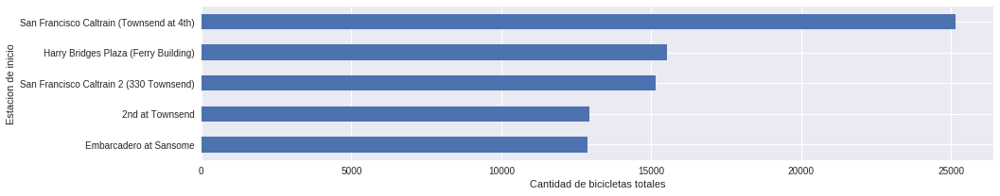

In [11]:
trips_2014[-5:].plot.barh(stacked=True, figsize=(15, 3));

plt.xlabel('Cantidad de bicicletas totales');
plt.ylabel('Estacion de inicio');

#### 2015

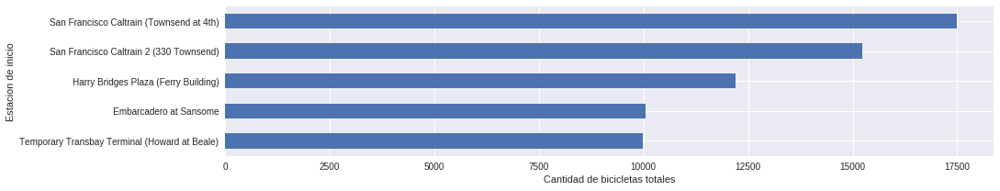

In [12]:
trips_2015[-5:].plot.barh(stacked=True, figsize=(15, 3));

plt.xlabel('Cantidad de bicicletas totales');
plt.ylabel('Estacion de inicio');

## Ploteando en mapas

In [13]:
def distancia_grados(dist, rad):
    '''funcion para calcular grados a partir de una distancia'''
    return (180 * dist) / (rad * PI)

offset = distancia_grados(40,6371)
# convertir 40km a grados. El otro parametro es el radio de la tierra (en km)

def mean(a, b):
    return (a + b) / 2

In [14]:
total_bikes = trips
bikes = total_bikes.groupby('ss_id').count()[['ss_name']].reset_index()

bikes.rename(columns={'ss_id':'id',
                      'ss_name':'count'
                     }, inplace=True)

station_bikes = pd.merge(stations, bikes, on='id')
del(station_bikes['dock_count'])

## Uso o Popularidad de Estaciones

Lo que se quiere ver ahora es, las estaciones de cada ciudad cada una con un tamaño diferente representando la cantidad de bicicletas que parten de dicha estacion (se utiliza la cantidad de bicicletas que parten de una estacion como medida de 'uso o popularidad' de una estacion)

Para lograr esto, debemos realizar lo siguiente:

1. Separar los viajes por ciudad.
2. Contar la cantidad de bicicletas que parten de una estacion.
3. Plotear en un mapa de cada ciudad, las estaciones y su uso

In [15]:
#Separamos por ciudades
sf = station_bikes[station_bikes['city'] == 'San Francisco']
sj = station_bikes[station_bikes['city'] == 'San Jose']
rc = station_bikes[station_bikes['city'] == 'Redwood City']
mv = station_bikes[station_bikes['city'] == 'Mountain View']
pa = station_bikes[station_bikes['city'] == 'Palo Alto']

#Calculo las latitudes
#Para incluir a todas las estaciones (en la visualizacion), no tomamos el promedio de todas las coordenadas
#sino que tomamos la coordenada media entre la coordenada maxima y minima
sf_lat, sf_lon = mean(sf.lat.max(), sf.lat.min()), mean(sf.long.max(), sf.long.min())
sj_lat, sj_lon = mean(sj.lat.max(), sj.lat.min()), mean(sj.long.max(), sj.long.min())
rc_lat, rc_lon = mean(rc.lat.max(), rc.lat.min()), mean(rc.long.max(), rc.long.min())
pa_lat, pa_lon = mean(pa.lat.max(), pa.lat.min()), mean(pa.long.max(), pa.long.min())
mv_lat, mv_lon = mean(mv.lat.max(), mv.lat.min()), mean(mv.long.max(), mv.long.min())

ciudades = [sf, sj, rc, mv, pa]
nombres = ['San Francisco', 'San Jose', 'Redwood City', 'Mountain View', 'Palo Alto']

for ciudad in ciudades:
    del(ciudad['date'])
    #del(ciudad['city'])

In [16]:
#Seteamos algunas variables para visualizar los mapas
proyeccion = 'merc'
resolucion = 'l'
epsg = 4326
marcador = 'o'
color = 'tomato'
servicio = 'NatGeo_World_Map'
x_tam, y_tam = 1000, 1000
radio_tierra_km = 6371

### San Francisco

/home/mk/datos/benv/lib/python2.7/site-packages/mpl_toolkits/basemap/__init__.py:3222: MatplotlibDeprecationWarning: The ishold function was deprecated in version 2.0.
  b = ax.ishold()
/home/mk/datos/benv/lib/python2.7/site-packages/mpl_toolkits/basemap/__init__.py:3231: MatplotlibDeprecationWarning: axes.hold is deprecated.
    See the API Changes document (http://matplotlib.org/api/api_changes.html)
    for more details.
  ax.hold(b)
/home/mk/datos/benv/lib/python2.7/site-packages/mpl_toolkits/basemap/__init__.py:3296: MatplotlibDeprecationWarning: The ishold function was deprecated in version 2.0.
  b = ax.ishold()
/home/mk/datos/benv/lib/python2.7/site-packages/mpl_toolkits/basemap/__init__.py:3305: MatplotlibDeprecationWarning: axes.hold is deprecated.
    See the API Changes document (http://matplotlib.org/api/api_changes.html)
    for more details.
  ax.hold(b)


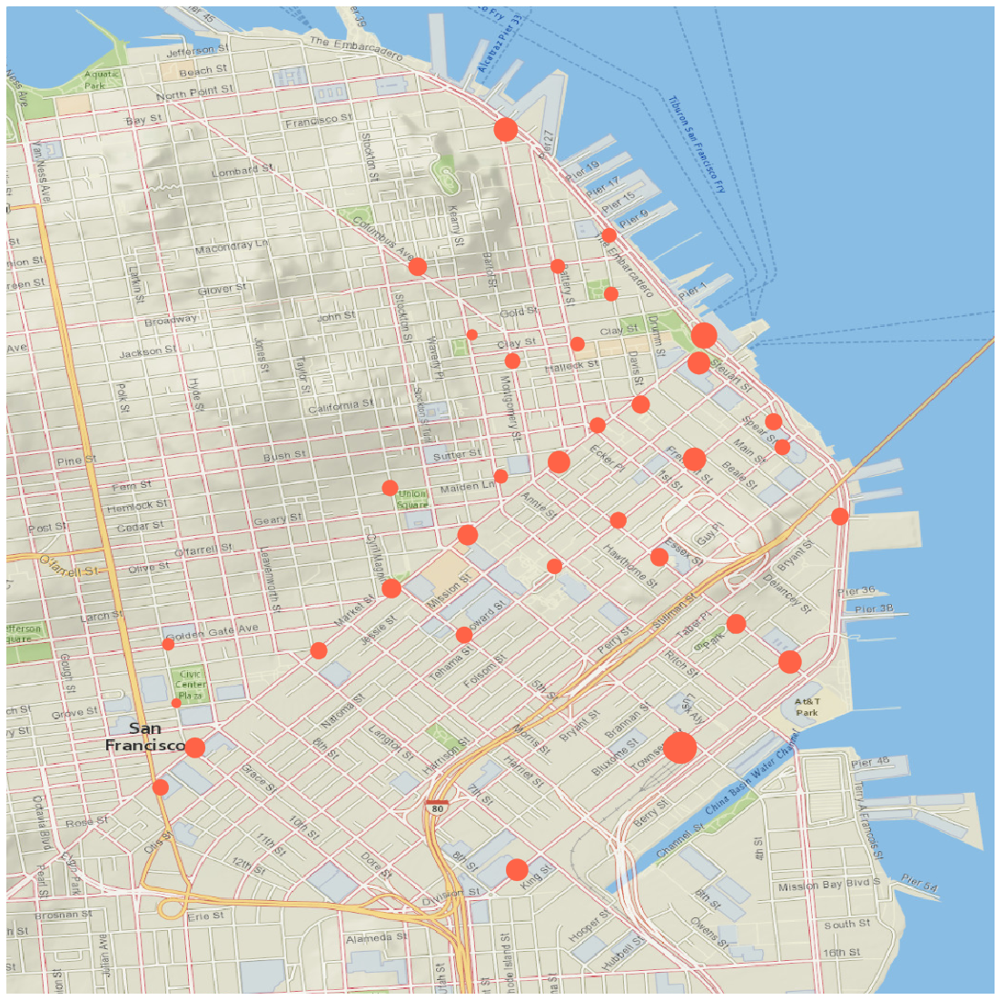

In [17]:
plt.figure(figsize=(20, 20))
offset = distancia_grados(2.5, radio_tierra_km)
sf_mapa = Basemap(projection=proyeccion, resolution=resolucion, epsg=epsg,
                  llcrnrlat=sf_lat - offset, llcrnrlon=sf_lon - offset,
                  urcrnrlat=sf_lat + offset, urcrnrlon=sf_lon + offset )

sf_mapa.scatter(sf[['long']].values, sf[['lat']].values, 
                s=sf[['count']].apply(lambda x:x/40), 
                marker=marcador, c=color )

sf_mapa.arcgisimage(service=servicio, xpixels=x_tam, ypixels=y_tam )
plt.show()

### San Jose

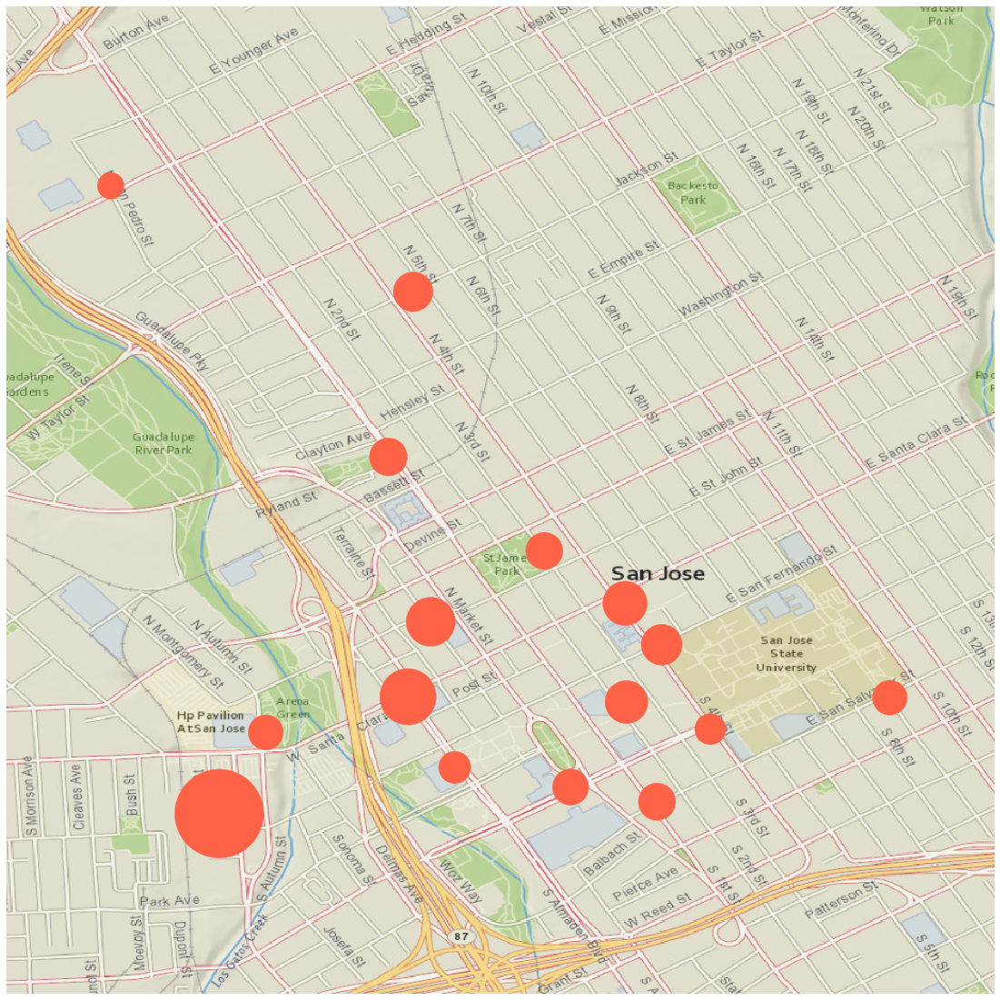

In [18]:
plt.figure(figsize=(20, 20))
offset = distancia_grados(2, radio_tierra_km)
sj_mapa = Basemap(projection=proyeccion, resolution=resolucion, epsg=epsg,
                  llcrnrlat=sj_lat - offset, llcrnrlon=sj_lon - offset,
                  urcrnrlat=sj_lat + offset, urcrnrlon=sj_lon + offset )

sj_mapa.scatter(sj[['long']].values, sj[['lat']].values, 
                s=sj[['count']], marker=marcador, c=color )

sj_mapa.arcgisimage(service=servicio, xpixels=x_tam, ypixels=y_tam )
plt.show()

### Redwood City

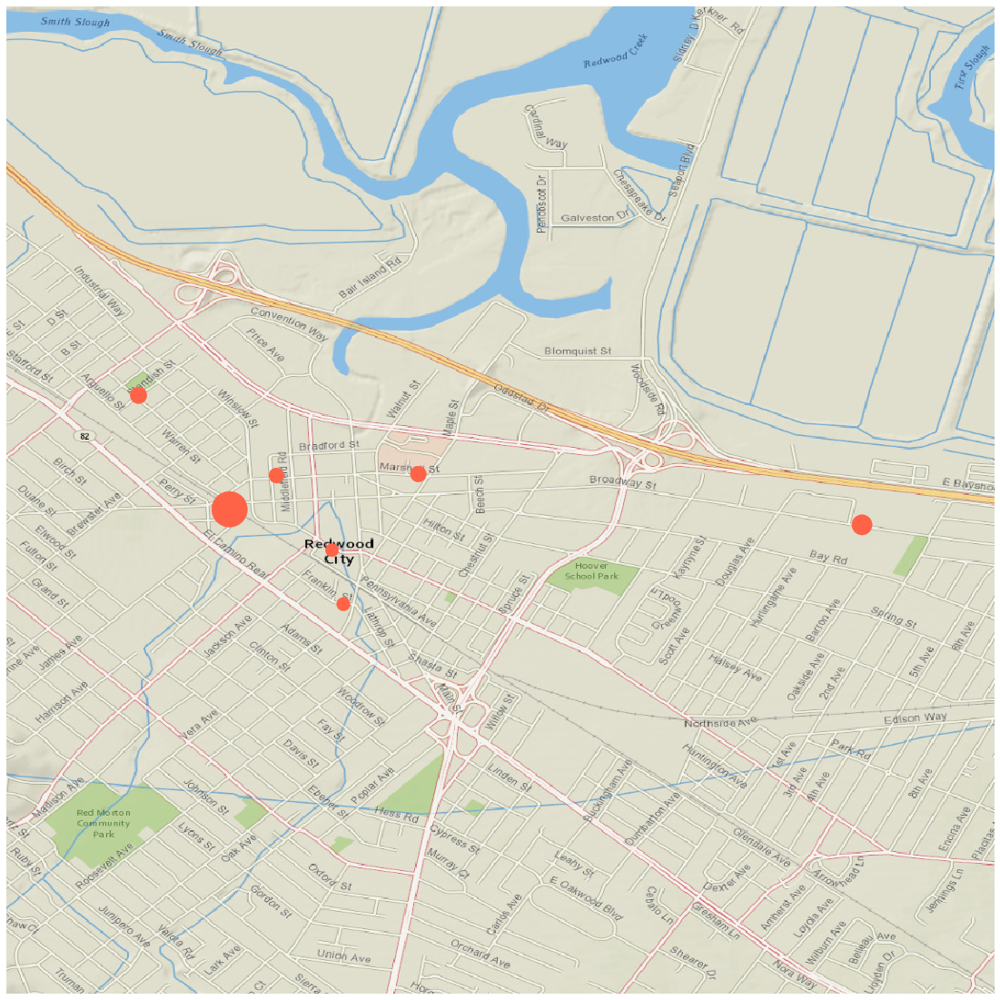

In [19]:
plt.figure(figsize=(20, 20))
offset = distancia_grados(2.5, radio_tierra_km)
rc_mapa = Basemap(projection=proyeccion, resolution=resolucion, epsg=epsg,
                  llcrnrlat=rc_lat - offset, llcrnrlon=rc_lon - offset,
                  urcrnrlat=rc_lat + offset, urcrnrlon=rc_lon + offset )

rc_mapa.scatter(rc[['long']].values, rc[['lat']].values,
                s=rc[['count']], marker=marcador, c=color )

rc_mapa.arcgisimage(service=servicio, xpixels=x_tam, ypixels=y_tam )
plt.show()

### Palo Alto

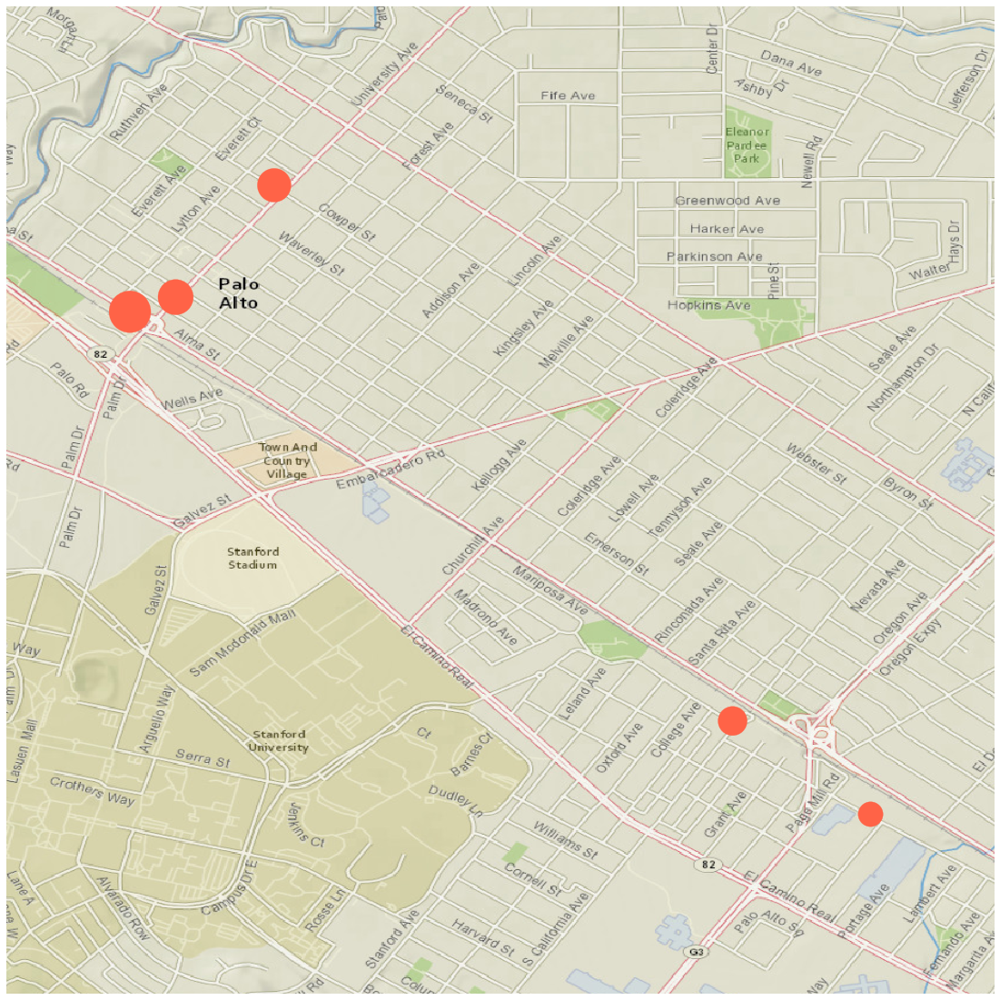

In [20]:
plt.figure(figsize=(20, 20))
offset = distancia_grados(2, radio_tierra_km)
pa_mapa = Basemap(projection=proyeccion, resolution=resolucion, epsg=epsg,
                  llcrnrlat=pa_lat - offset, llcrnrlon=pa_lon - offset,
                  urcrnrlat=pa_lat + offset, urcrnrlon=pa_lon + offset )

pa_mapa.scatter(pa[['long']].values, pa[['lat']].values,
                s=pa[['count']], marker=marcador, c=color )

pa_mapa.arcgisimage(service=servicio, xpixels=x_tam, ypixels=y_tam )
plt.show()

### Mountain View

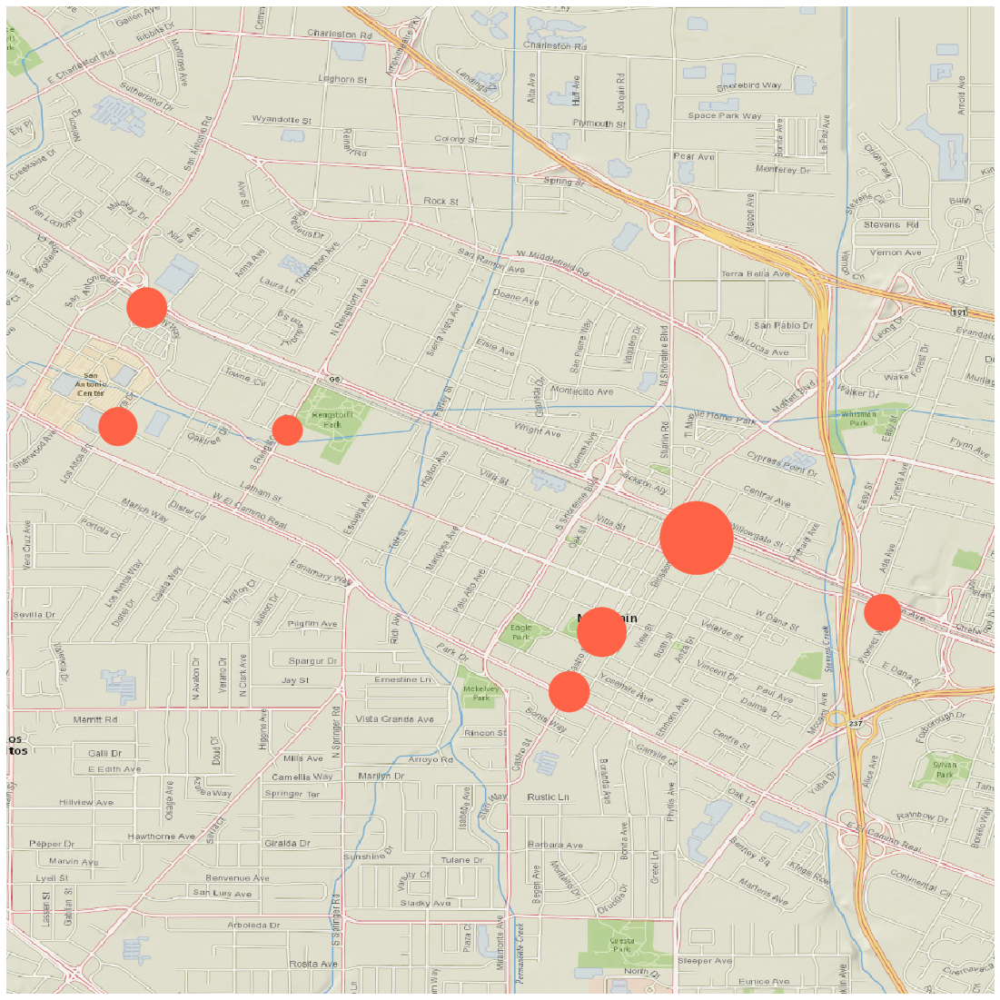

In [21]:
plt.figure(figsize=(20, 20))
offset = distancia_grados(3, radio_tierra_km)
mv_mapa = Basemap(projection=proyeccion, resolution=resolucion, epsg=epsg,
                  llcrnrlat=mv_lat - offset, llcrnrlon=mv_lon - offset,
                  urcrnrlat=mv_lat + offset, urcrnrlon=mv_lon + offset )

mv_mapa.scatter(mv[['long']].values, mv[['lat']].values,
                s=mv[['count']], marker=marcador, c=color )

mv_mapa.arcgisimage(service=servicio, xpixels=x_tam, ypixels=y_tam )
plt.show()

### Comparando todas las ciudades

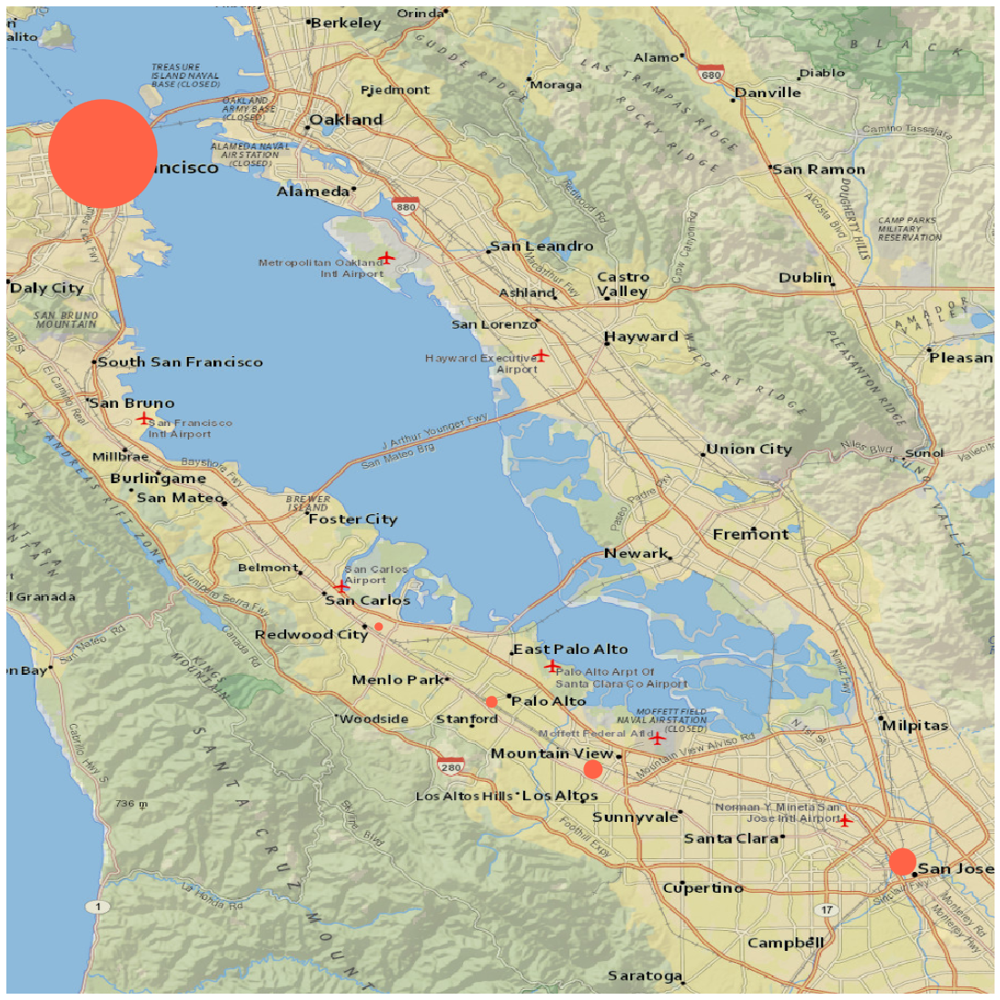

In [22]:
lons = []
lats = []
sizes = []

for ciudad in ciudades:
    lons.append(ciudad['long'].mean())
    lats.append(ciudad['lat'].mean())
    sizes.append(ciudad['count'].sum() / 42)

max_lat, max_lon = station_bikes.max()[['lat','long']]
min_lat, min_lon = station_bikes.min()[['lat','long']]
lat, lon = mean(max_lat,min_lat), mean(max_lon,min_lon)

plt.figure(figsize=(20, 20))
offset = distancia_grados(35, radio_tierra_km)
mapa = Basemap(projection=proyeccion, resolution=resolucion, epsg=epsg,
               llcrnrlat=lat - offset, llcrnrlon=lon - offset,
               urcrnrlat=lat + offset, urcrnrlon=lon + offset )
    
mapa.scatter(lons, lats, s=sizes, marker=marcador, c=color )

mapa.arcgisimage(service=servicio, xpixels=x_tam,  ypixels=y_tam )
plt.show()

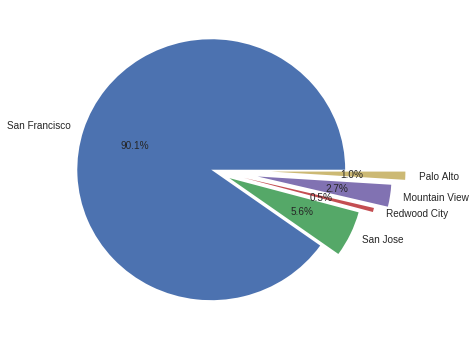

In [23]:
plt.figure(figsize=(6, 6))
plt.pie(sizes, labels=nombres, autopct='%1.1f%%', explode=(0,.15,.25,.35,.45) )
plt.show()

In [24]:
#Dataframe con los nombres de todas las estaciones y sus coordenadas
ss_location = stations[['name', 'lat', 'long', 'city']]
ss_location.rename(columns={'name':'ss_name',
                            'lat':'s_lat',
                            'long':'s_lon',
                            'city':'s_city'
                           }, inplace=True)

es_location = stations[['name', 'lat', 'long', 'city']]
es_location.rename(columns={'name':'es_name',
                            'lat':'e_lat',
                            'long':'e_lon',
                            'city':'e_city'
                           }, inplace=True)

/home/mk/datos/benv/lib/python2.7/site-packages/pandas/core/frame.py:2834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  **kwargs)


### Trayectos mas frecuentes

Lo que queremos lograr ahora es, mostrar en un mapa, los viajes entre estaciones mas utilizados.

Para ello se necesita saber cuales son los viajes que se hacen (entre cuales estaciones).

Ademas de calcular los trayectos hay que juntar los que estan repetidos. Los trayectos con mas repeticiones son los mas frecuentes.

In [25]:
trayectos_frec = trips[['id', 'ss_name', 'es_name']].groupby(['es_name', 'ss_name'], as_index=False).count()

# Añadimos al dataframe, las ubicaciones de cada estacion
trayectos_frec = pd.merge(trayectos_frec, ss_location, on='ss_name')
trayectos_frec = pd.merge(trayectos_frec, es_location, on='es_name')

trayectos_frec.rename(columns={'id':'count'}, inplace=True)

In [29]:
def reducir_trayectos(trayectos_frec):
    #El trayecto A -> B es el mismo que B -> A
    #Esta funcion junta las repeticiones de estos trayectos
    l=[]
    trayectos_frec_reduc = trayectos_frec
    for i in range(len(trayectos_frec_reduc)-1):
        if i not in l:
            prim = trayectos_frec_reduc.loc[i]
            for j in range(i, len(trayectos_frec_reduc)):
                if j not in l: 
                    seg = trayectos_frec_reduc.loc[j]
                    if prim.ss_name == seg.es_name and prim.es_name == seg.ss_name:
                        trayectos_frec_reduc.loc[i]['count'] += trayectos_frec_reduc.loc[j]['count']
                        trayectos_frec_reduc = trayectos_frec_reduc.drop(j)
                        l.append(j)
    return trayectos_frec_reduc

tf = reducir_trayectos(trayectos_frec)

/home/mk/datos/benv/lib/python2.7/site-packages/ipykernel/__main__.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [30]:
sf_trayectos = tf[(tf['s_city'] == 'San Francisco') & \
                  (tf['e_city'] == 'San Francisco')].drop(['s_city','e_city'],1)
sj_trayectos = tf[(tf['s_city'] == 'San Jose') & \
                  (tf['e_city'] == 'San Jose')].drop(['s_city','e_city'],1)
rc_trayectos = tf[(tf['s_city'] == 'Redwood City') & \
                  (tf['e_city'] == 'Redwood City')].drop(['s_city','e_city'],1)
mv_trayectos = tf[(tf['s_city'] == 'Mountain View') & \
                  (tf['e_city'] == 'Mountain View')].drop(['s_city','e_city'],1)
pa_trayectos = tf[(tf['s_city'] == 'Palo Alto') & \
                  (tf['e_city'] == 'Palo Alto')].drop(['s_city','e_city'],1)

sf_trayectos.reset_index(drop=True, inplace=True)
sj_trayectos.reset_index(drop=True, inplace=True)
rc_trayectos.reset_index(drop=True, inplace=True)
mv_trayectos.reset_index(drop=True, inplace=True)
pa_trayectos.reset_index(drop=True, inplace=True)

In [31]:
viajes = {'sf':([], sf_trayectos),
          'sj':([], sj_trayectos),
          'rc':([], rc_trayectos),
          'mv':([], mv_trayectos),
          'pa':([], pa_trayectos)
         }

for v in viajes:
    max_val = 0
    for indice in range(len(viajes[v][1])):
        trayecto = viajes[v][1].loc[indice]
        if trayecto['count'] > max_val: 
            max_val = trayecto['count']

    for indice in range(len(viajes[v][1])):
        trayecto = viajes[v][1].loc[indice]
        #Mapeo de la frecuencia del trayecto al intervalo [0;255]
        color = int(255 / float(max_val) * trayecto['count'])
        color = abs(255 - color)
        viajes[v][0].append(([trayecto.s_lon, trayecto.e_lon], #longitud de la estacion inicial y final (respectivamente)
                             [trayecto.s_lat, trayecto.e_lat], #latitud de la estacion inicial y final (respectivamente)
                             color)                            #frecuencia del trayecto, que sera utilizado para colorear a la arista en la visualizacion
                           )

    #Colocamos los viajes mas frecuentes al final
    viajes[v][0].sort(key=lambda x: -x[2])

### San Francisco

/home/mk/datos/benv/lib/python2.7/site-packages/mpl_toolkits/basemap/__init__.py:3260: MatplotlibDeprecationWarning: The ishold function was deprecated in version 2.0.
  b = ax.ishold()
/home/mk/datos/benv/lib/python2.7/site-packages/mpl_toolkits/basemap/__init__.py:3269: MatplotlibDeprecationWarning: axes.hold is deprecated.
    See the API Changes document (http://matplotlib.org/api/api_changes.html)
    for more details.
  ax.hold(b)


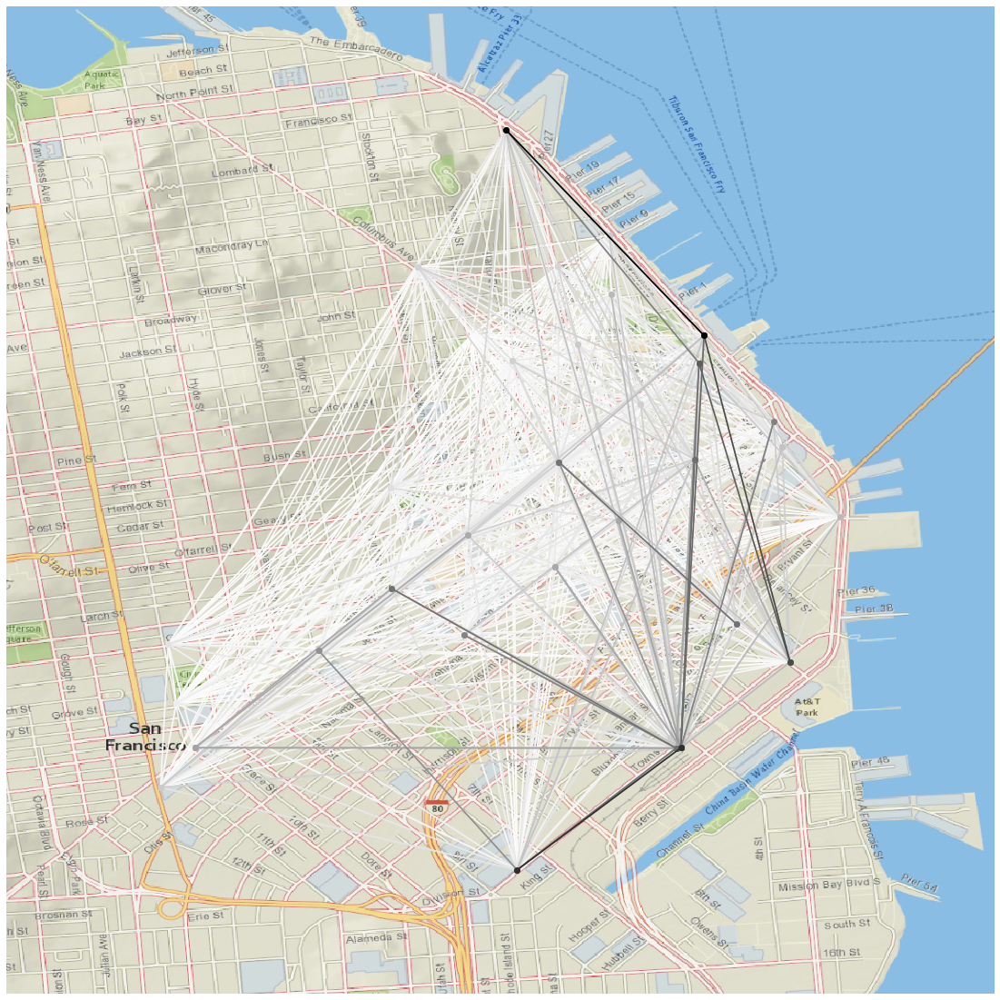

In [32]:
plt.figure(figsize=(20, 20))
offset = distancia_grados(2.5, radio_tierra_km)
sf_mapa = Basemap(projection=proyeccion, resolution=resolucion, epsg=epsg,
                  llcrnrlat=sf_lat - offset, llcrnrlon=sf_lon - offset,
                  urcrnrlat=sf_lat + offset, urcrnrlon=sf_lon + offset )

for trayecto in viajes['sf'][0]:
    color = trayecto[2]
    col = str(hex(color)).replace('0x','')
    if color < 16: color = '#' + ('0' + col) * 3
    else: color = '#' + col * 3
    sf_mapa.plot(trayecto[0], trayecto[1], 'o-', color=color)

sf_mapa.arcgisimage(service=servicio, xpixels=x_tam, ypixels=y_tam )
plt.show()

### San Jose

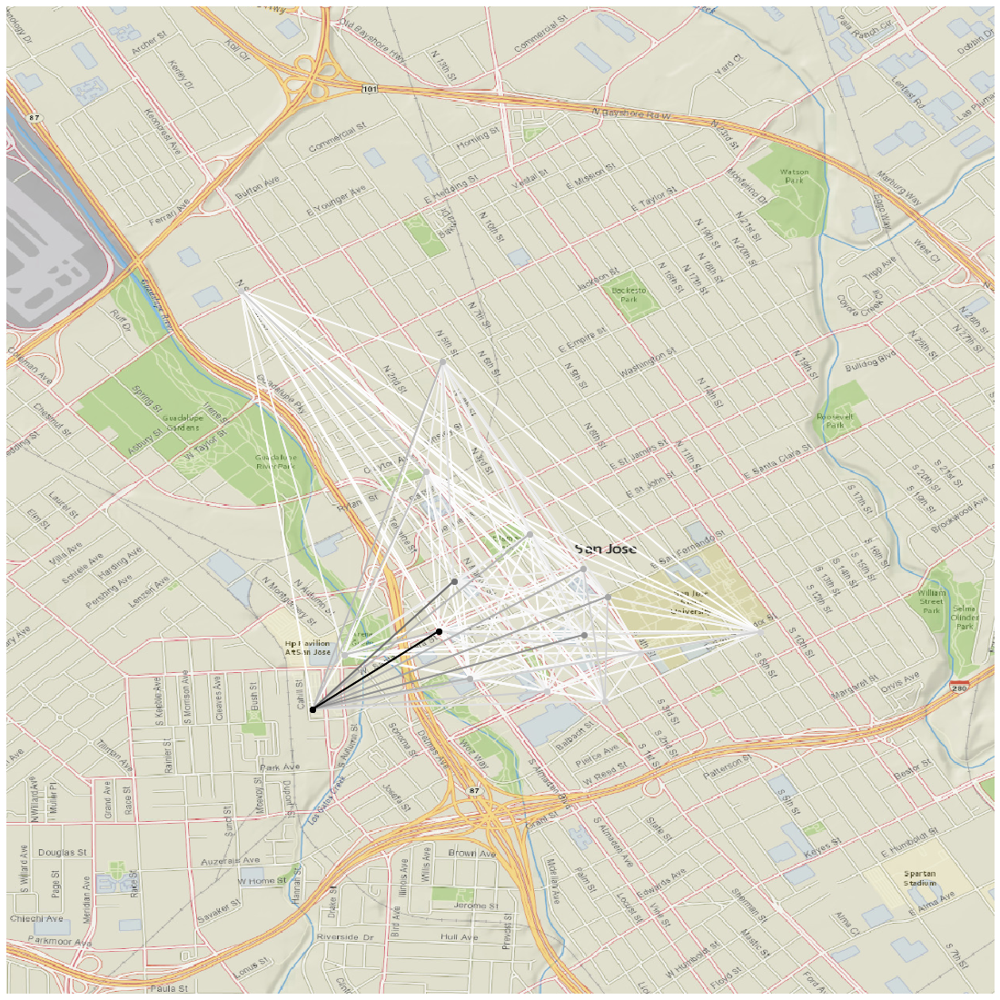

In [33]:
plt.figure(figsize=(20, 20))
offset = distancia_grados(3, radio_tierra_km)
sj_mapa = Basemap(projection=proyeccion, resolution=resolucion, epsg=epsg,
                  llcrnrlat=sj_lat - offset, llcrnrlon=sj_lon - offset,
                  urcrnrlat=sj_lat + offset, urcrnrlon=sj_lon + offset )

for trayecto in viajes['sj'][0]:
    color = trayecto[2]
    col = str(hex(color)).replace('0x','')
    if color < 16: color = '#' + ('0' + col) * 3
    else: color = '#' + col * 3
    sj_mapa.plot(trayecto[0], trayecto[1], 'o-', color=color)

sj_mapa.arcgisimage(service=servicio, xpixels=x_tam, ypixels=y_tam )
plt.show()

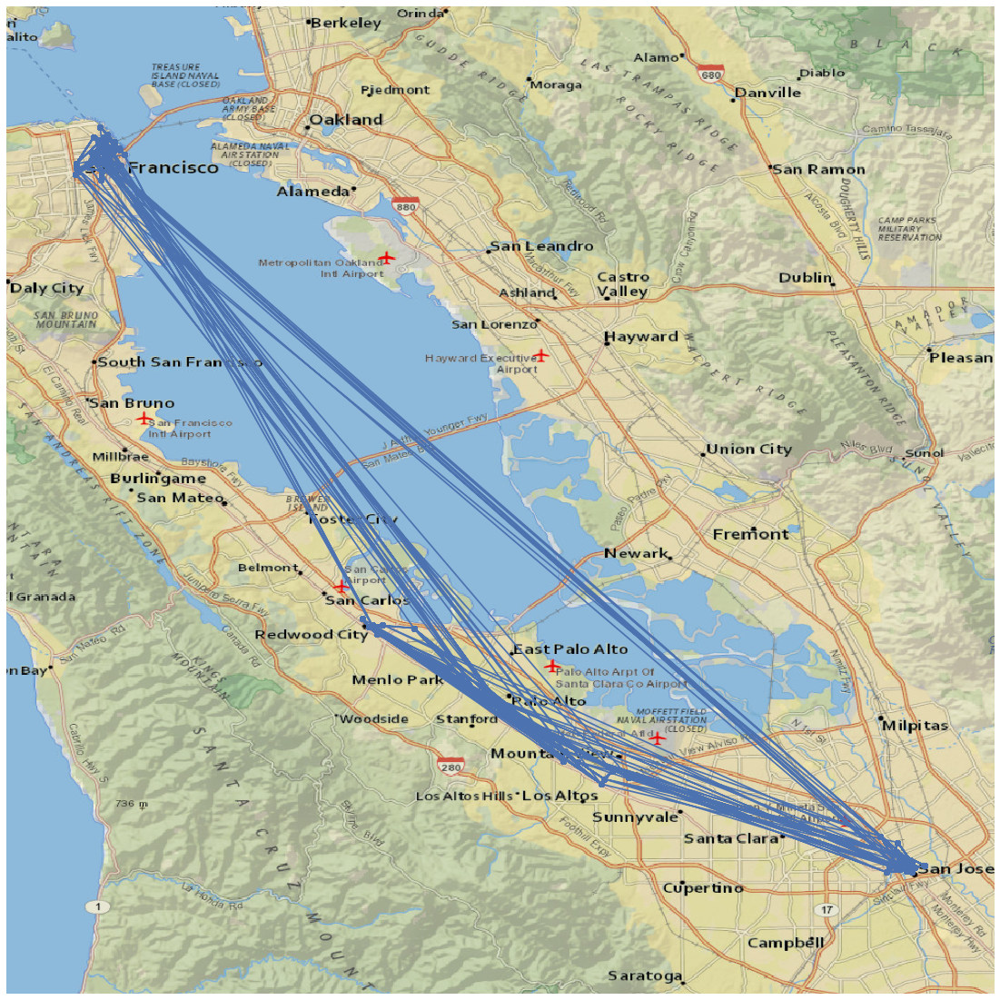

In [34]:
plt.figure(figsize=(20, 20))
offset = distancia_grados(35, radio_tierra_km)
mapa = Basemap(projection=proyeccion, resolution=resolucion, epsg=epsg,
               llcrnrlat=lat - offset, llcrnrlon=lon - offset,
               urcrnrlat=lat + offset, urcrnrlon=lon + offset )

mapa.plot(tf['s_lon'], tf['s_lat'], 'o-' )

mapa.arcgisimage(service=servicio, xpixels=x_tam, ypixels=y_tam)
plt.show()

#### Comparacion de uso de las estaciones en escala logaritmica

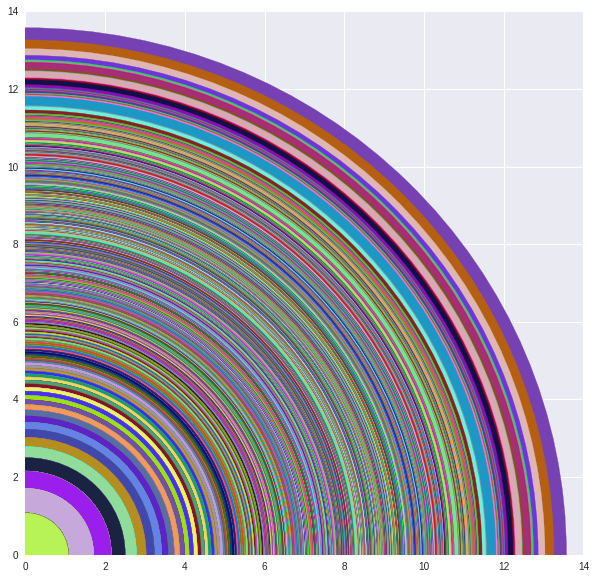

In [35]:
fig, ax = plt.subplots()
ax.set_xlim((0, 14))
ax.set_ylim((0, 14))
fig.set_size_inches(10, 10)

for tr_frec in tf['count'].sort_values(ascending=False):
    ax.add_artist(plt.Circle((0, 0), log(tr_frec)*14/9, color='#%02X%02X%02X' % (rand(0, 255), rand(0, 255), rand(0, 255))))

plt.show();